## Import Modules

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

## Load the files

In [2]:
BASE_DIR = 'Data/data'

In [3]:
# load complete image paths to the list
image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)

In [4]:
image_paths[:5]

['Data/data\\1.png',
 'Data/data\\10.png',
 'Data/data\\100.png',
 'Data/data\\1000.png',
 'Data/data\\10000.png']

In [5]:
# remove unnecessary file
# image_paths.remove('Data/data')

In [7]:
len(image_paths)

6023

## Visualize the Image Dataset

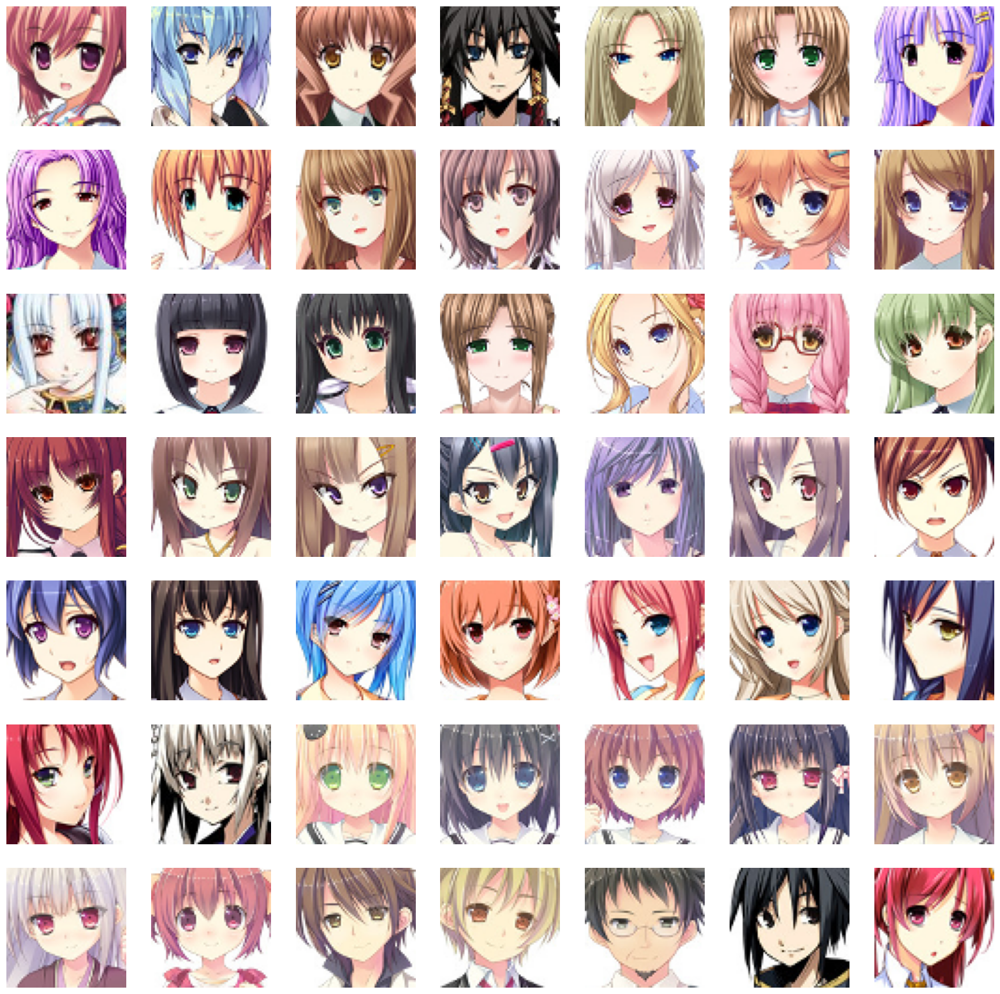

In [8]:
# to display grid of images (7x7)
plt.figure(figsize=(20, 20))
temp_images = image_paths[:49]
index = 1

for image_path in temp_images:
    plt.subplot(7, 7, index)
    # load the image
    img = load_img(image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # increment the index for next image
    index += 1

## Preprocess Images

In [9]:
# load the image and convert to numpy array
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/6023 [00:00<?, ?it/s]

In [10]:
train_images[0].shape

(64, 64, 3)

In [11]:
# reshape the array
train_images = train_images.reshape(train_images.shape[0], 64, 64, 3).astype('float32')

In [12]:
# normalize the images
train_images = (train_images - 127.5) / 127.5

In [13]:
train_images[0]

array([[[ 0.94509804,  0.42745098,  0.24705882],
        [ 0.96862745,  0.44313726,  0.33333334],
        [ 0.9529412 ,  0.5058824 ,  0.35686275],
        ...,
        [ 0.38039216, -0.38039216, -0.19215687],
        [ 0.43529412, -0.34117648, -0.15294118],
        [ 0.49019608, -0.1764706 , -0.02745098]],

       [[ 0.90588236,  0.43529412,  0.23137255],
        [ 0.92941177,  0.43529412,  0.3254902 ],
        [ 0.9529412 ,  0.44313726,  0.35686275],
        ...,
        [ 0.33333334, -0.3647059 , -0.19215687],
        [ 0.39607844, -0.37254903, -0.16862746],
        [ 0.35686275, -0.3647059 , -0.19215687]],

       [[ 0.8980392 ,  0.4117647 ,  0.2627451 ],
        [ 0.96862745,  0.4745098 ,  0.33333334],
        [ 0.75686276,  0.14509805,  0.16078432],
        ...,
        [ 0.40392157, -0.31764707, -0.12156863],
        [ 0.38039216, -0.37254903, -0.16078432],
        [ 0.35686275, -0.40392157, -0.20784314]],

       ...,

       [[ 1.        ,  1.        ,  1.        ],
        [ 1

## Create Generator & Discriminator Models

In [14]:
# latent dimension for random noise
LATENT_DIM = 100
# weight initializer
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# no. of channels of the image
CHANNELS = 3 # for gray scale, keep it as 1

### Generator Model

Generator Model will create new images similar to training data from random noise

In [15]:
model = Sequential(name='generator')

# 1d random noise
model.add(layers.Dense(8 * 8 * 512, input_dim=LATENT_DIM))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# convert 1d to 3d
model.add(layers.Reshape((8, 8, 512)))

# upsample to 16x16
model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 32x32
model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 64x64
model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh'))

generator = model
generator.summary()

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense (Dense)                        │ (None, 32768)               │       3,309,568 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu (ReLU)                         │ (None, 32768)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape (Reshape)                    │ (None, 8, 8, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose (Conv2DTranspose)   │ (None, 16, 16, 256)         │       2,097,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_1 (ReLU)                       │ (None, 16, 16, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_1 (Conv2DTranspose) │ (None, 32, 32, 128)         │         524,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_2 (ReLU)                       │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_2 (Conv2DTranspose) │ (None, 64, 64, 64)          │         131,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_3 (ReLU)                       │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 64, 64, 3)           │           3,075 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,065,603 (23.14 MB)

 Trainable params: 6,065,603 (23.14 MB)

 Non-trainable params: 0 (0.00 B)

### Discriminator Model

Discriminator model will classify the image from the generator to check whether it real (or) fake images.

In [16]:
model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2

# create conv layers
model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# output class
model.add(layers.Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_1 (Conv2D)                    │ (None, 32, 32, 64)          │           3,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 32, 32, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu (LeakyReLU)              │ (None, 32, 32, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 16, 16, 128)         │         131,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 16, 16, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_1 (LeakyReLU)            │ (None, 16, 16, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 8, 8, 128)           │         262,272 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 8, 8, 128)           │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_2 (LeakyReLU)            │ (None, 8, 8, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │           8,193 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 406,081 (1.55 MB)

 Trainable params: 405,441 (1.55 MB)

 Non-trainable params: 640 (2.50 KB)

## Create DCGAN

In [17]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')
        
    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]
    
    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn
        
    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))
        
        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)
            
            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)
            
            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2
            
        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))
        
        
        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)
            
        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))
        
        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)
        
        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

In [18]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()
        
        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        # plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()
        
    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

In [19]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

In [20]:
D_LR = 0.0001 
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

Epoch 1/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 2.1251 - g_loss: 0.6381

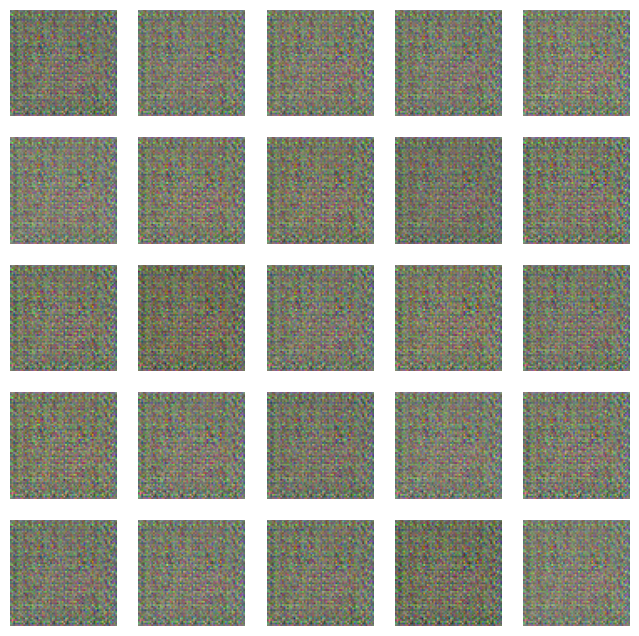

189/189 ━━━━━━━━━━━━━━━━━━━━ 347s 2s/step - d_loss: 2.1233 - g_loss: 0.6424
Epoch 2/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6618 - g_loss: 2.8956

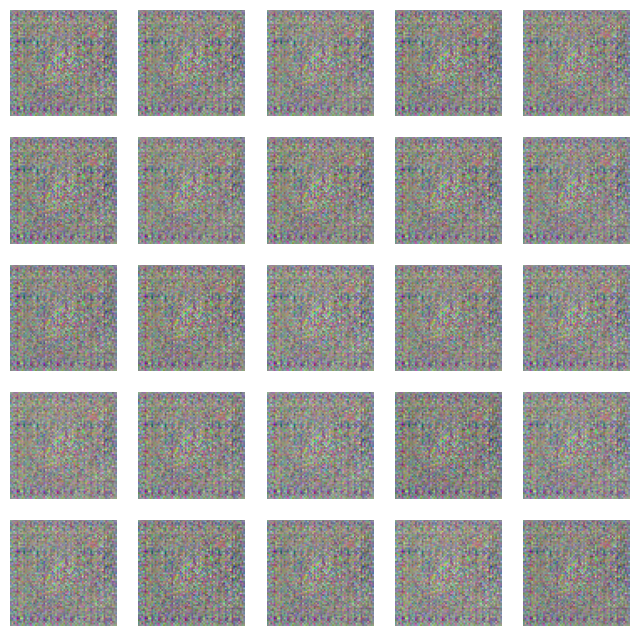

189/189 ━━━━━━━━━━━━━━━━━━━━ 365s 2s/step - d_loss: 0.6609 - g_loss: 2.8959
Epoch 3/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.1735 - g_loss: 3.0770

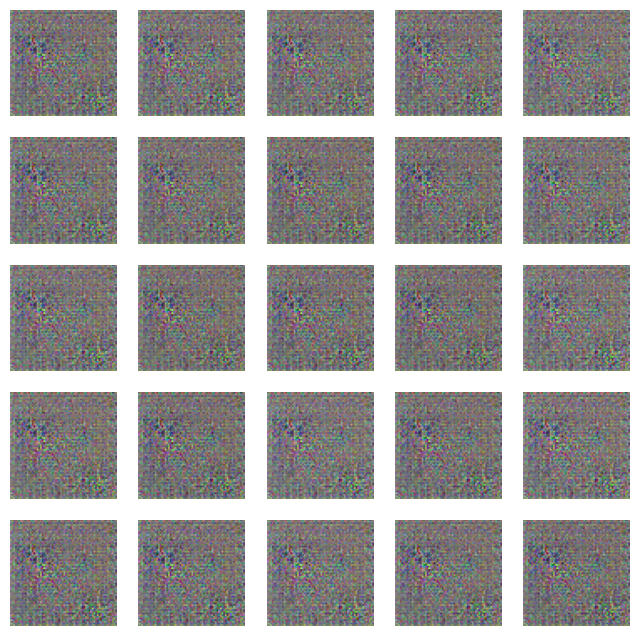

189/189 ━━━━━━━━━━━━━━━━━━━━ 342s 2s/step - d_loss: 0.1733 - g_loss: 3.0775
Epoch 4/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.0140 - g_loss: 3.5003

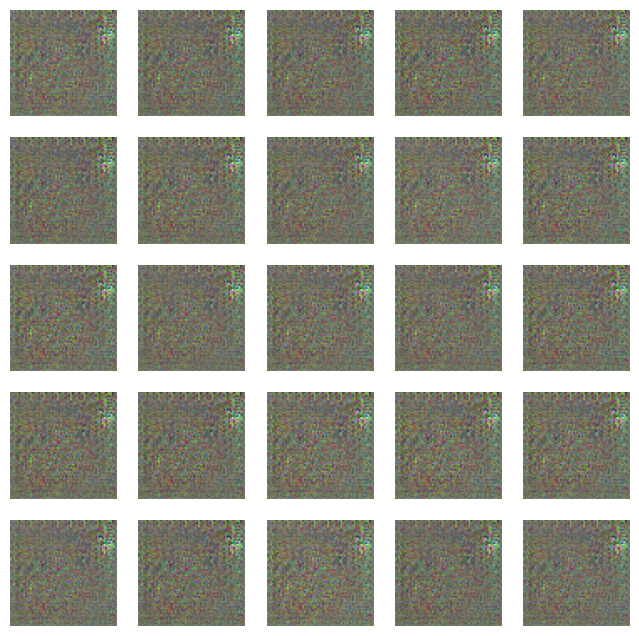

189/189 ━━━━━━━━━━━━━━━━━━━━ 418s 2s/step - d_loss: 0.0140 - g_loss: 3.5009
Epoch 5/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.0213 - g_loss: 3.7813

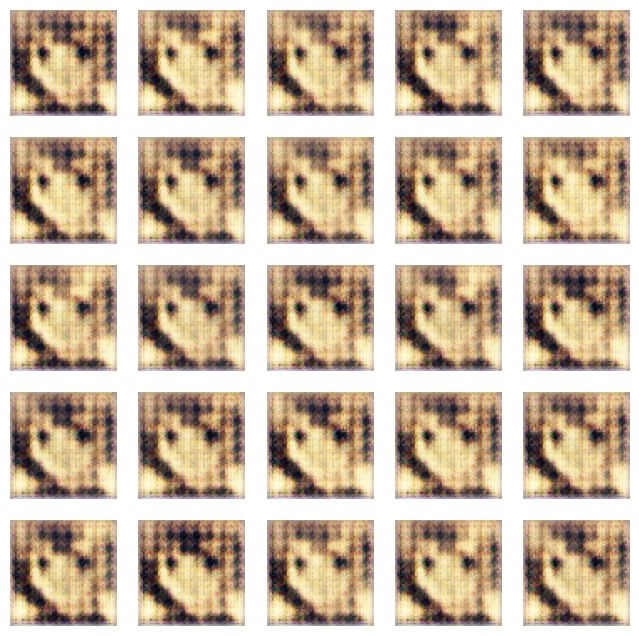

189/189 ━━━━━━━━━━━━━━━━━━━━ 447s 2s/step - d_loss: 0.0225 - g_loss: 3.7789
Epoch 6/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.5698 - g_loss: 1.9905

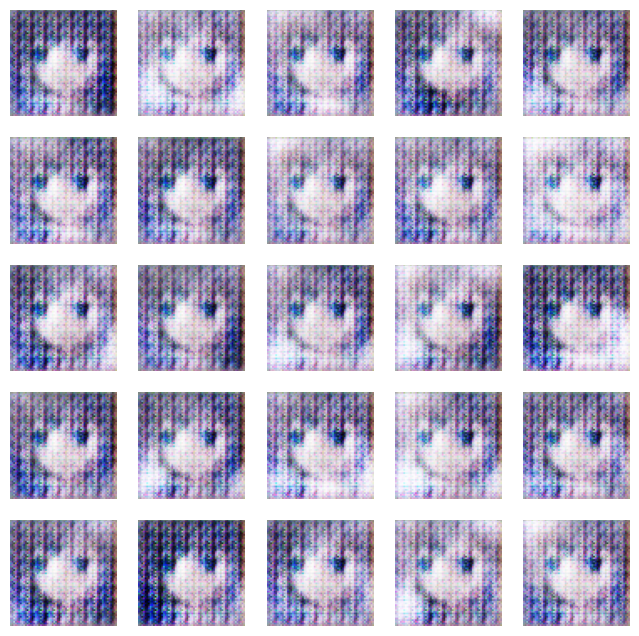

189/189 ━━━━━━━━━━━━━━━━━━━━ 453s 2s/step - d_loss: 0.5698 - g_loss: 1.9896
Epoch 7/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.5429 - g_loss: 1.8365

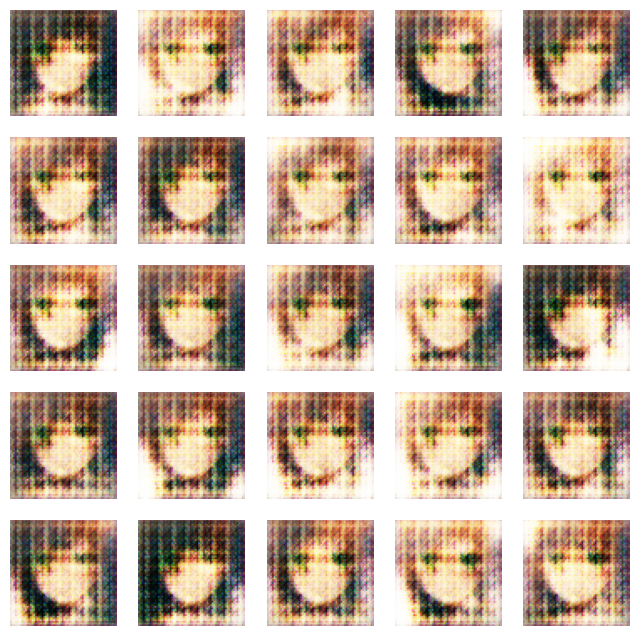

189/189 ━━━━━━━━━━━━━━━━━━━━ 447s 2s/step - d_loss: 0.5430 - g_loss: 1.8362
Epoch 8/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - d_loss: 0.5872 - g_loss: 1.7326

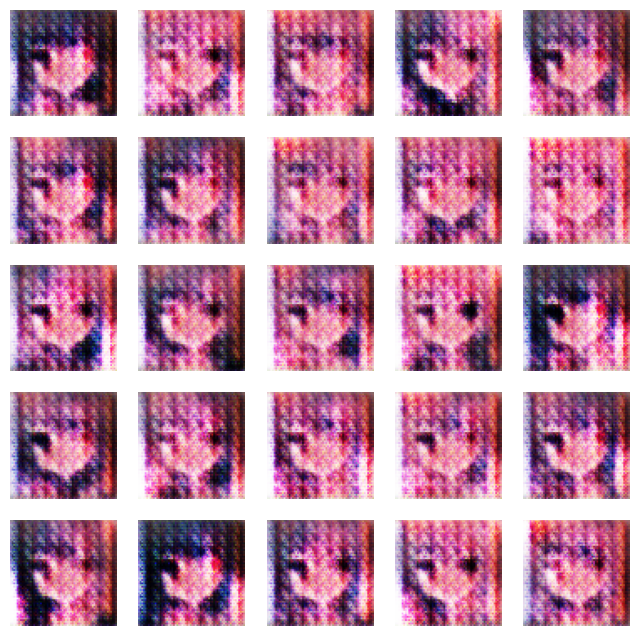

189/189 ━━━━━━━━━━━━━━━━━━━━ 480s 3s/step - d_loss: 0.5872 - g_loss: 1.7327
Epoch 9/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.5880 - g_loss: 1.7282

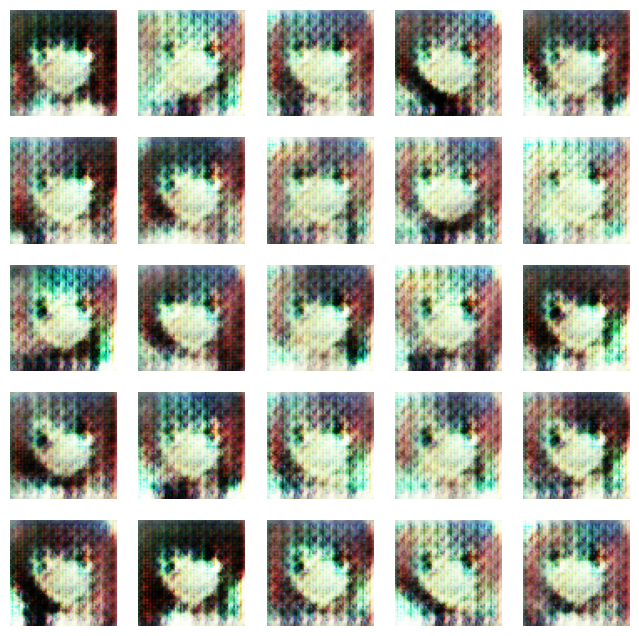

189/189 ━━━━━━━━━━━━━━━━━━━━ 432s 2s/step - d_loss: 0.5880 - g_loss: 1.7282
Epoch 10/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6244 - g_loss: 1.6364

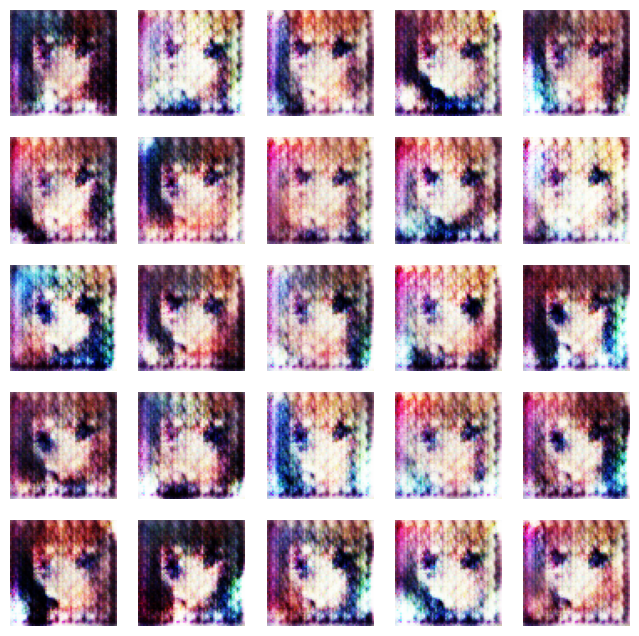

189/189 ━━━━━━━━━━━━━━━━━━━━ 442s 2s/step - d_loss: 0.6243 - g_loss: 1.6363
Epoch 11/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - d_loss: 0.6517 - g_loss: 1.5371

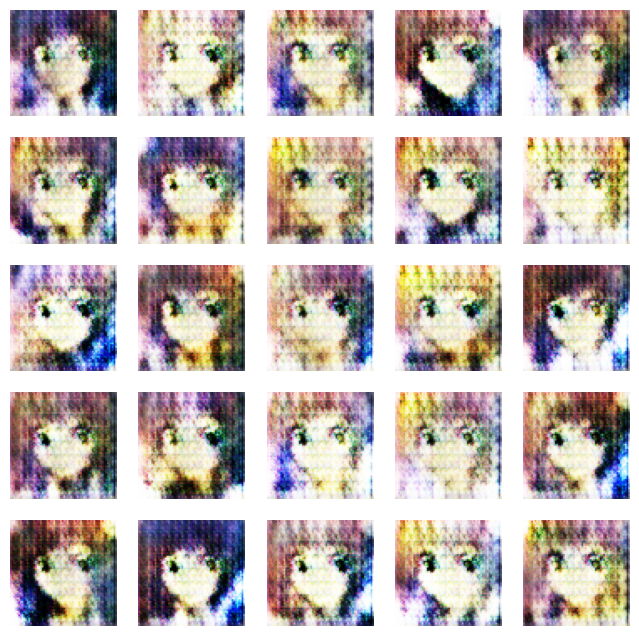

189/189 ━━━━━━━━━━━━━━━━━━━━ 482s 3s/step - d_loss: 0.6516 - g_loss: 1.5371
Epoch 12/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6265 - g_loss: 1.6147

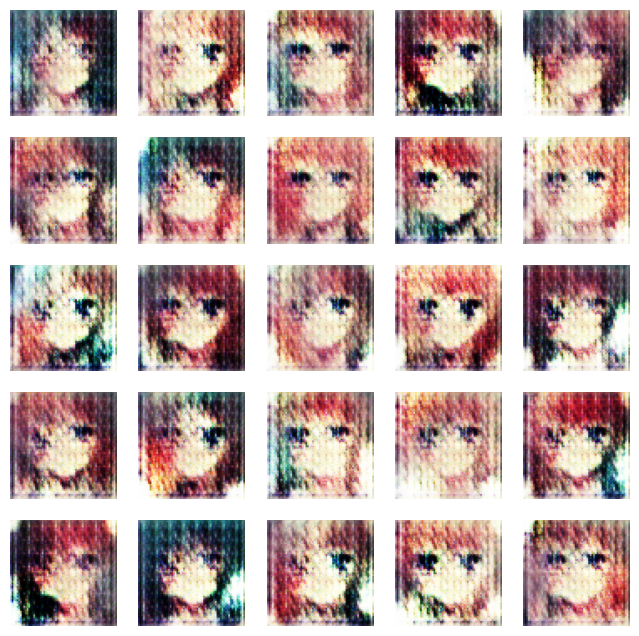

189/189 ━━━━━━━━━━━━━━━━━━━━ 462s 2s/step - d_loss: 0.6266 - g_loss: 1.6146
Epoch 13/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6243 - g_loss: 1.6049

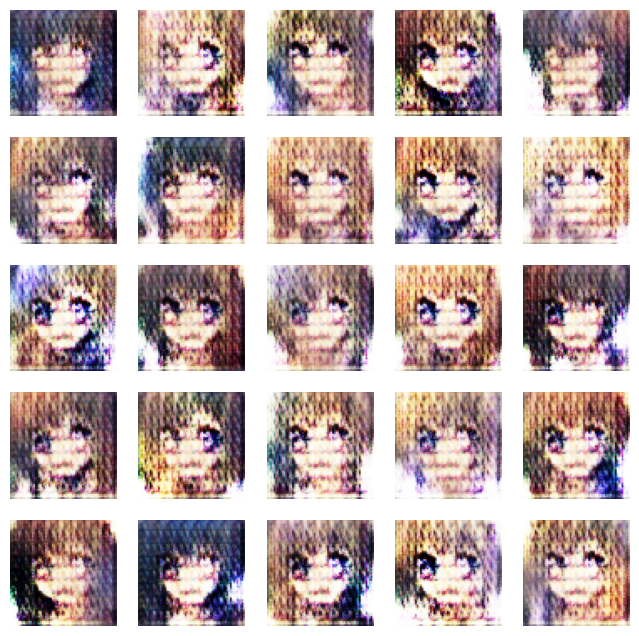

189/189 ━━━━━━━━━━━━━━━━━━━━ 468s 2s/step - d_loss: 0.6241 - g_loss: 1.6050
Epoch 14/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6239 - g_loss: 1.6933

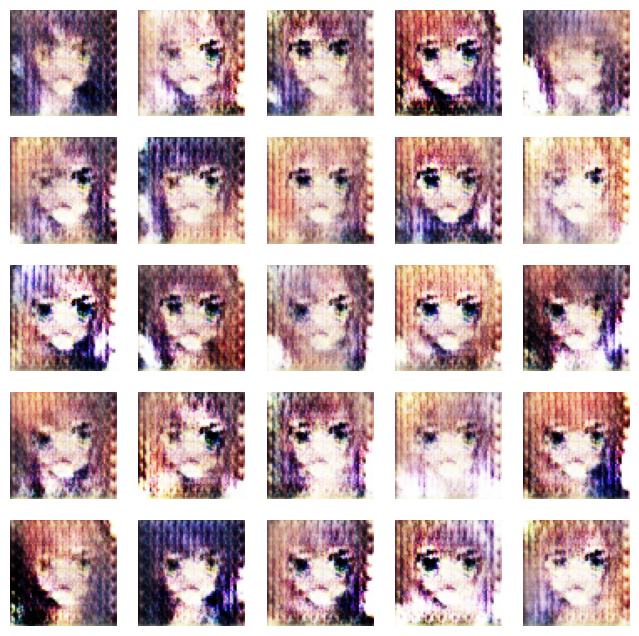

189/189 ━━━━━━━━━━━━━━━━━━━━ 463s 2s/step - d_loss: 0.6239 - g_loss: 1.6933
Epoch 15/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - d_loss: 0.6197 - g_loss: 1.6500

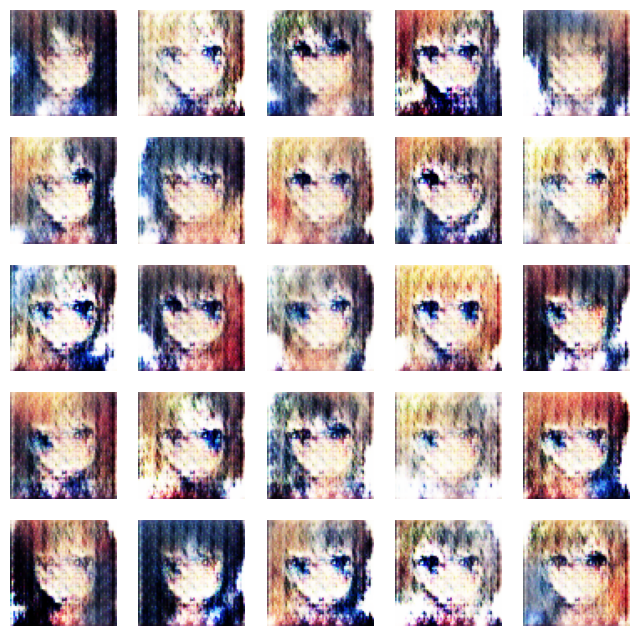

189/189 ━━━━━━━━━━━━━━━━━━━━ 485s 3s/step - d_loss: 0.6196 - g_loss: 1.6499
Epoch 16/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6583 - g_loss: 1.6266

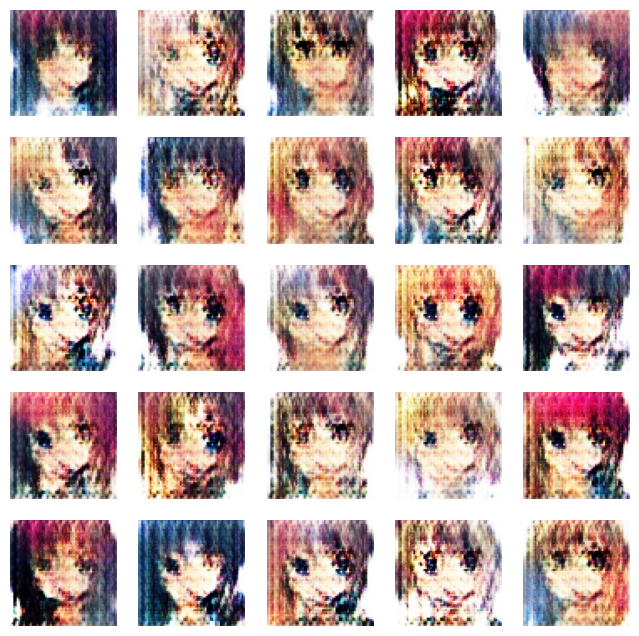

189/189 ━━━━━━━━━━━━━━━━━━━━ 461s 2s/step - d_loss: 0.6581 - g_loss: 1.6262
Epoch 17/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6569 - g_loss: 1.4797

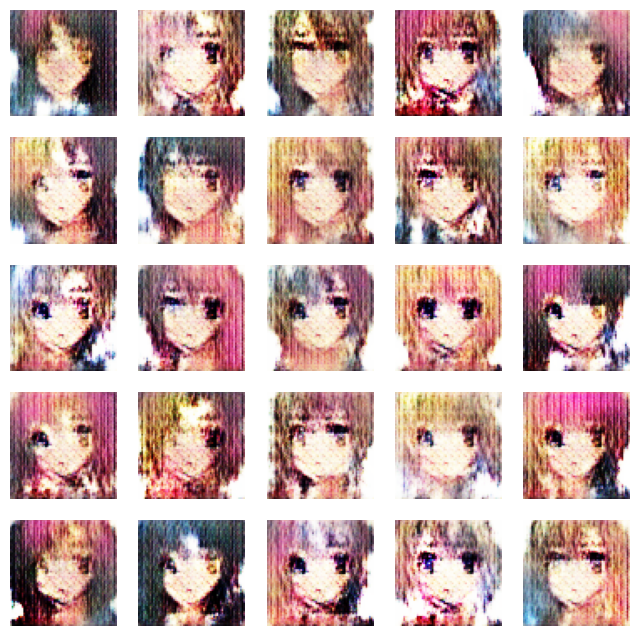

189/189 ━━━━━━━━━━━━━━━━━━━━ 441s 2s/step - d_loss: 0.6569 - g_loss: 1.4795
Epoch 18/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6327 - g_loss: 1.3979

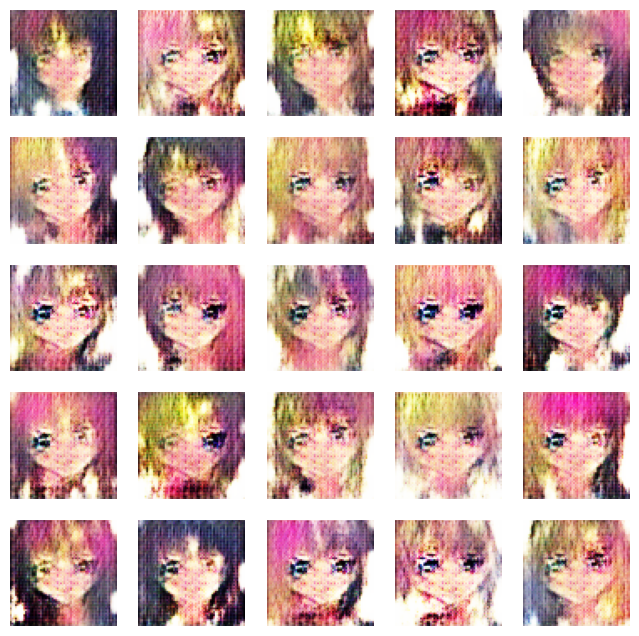

189/189 ━━━━━━━━━━━━━━━━━━━━ 419s 2s/step - d_loss: 0.6328 - g_loss: 1.3979
Epoch 19/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.5995 - g_loss: 1.5280

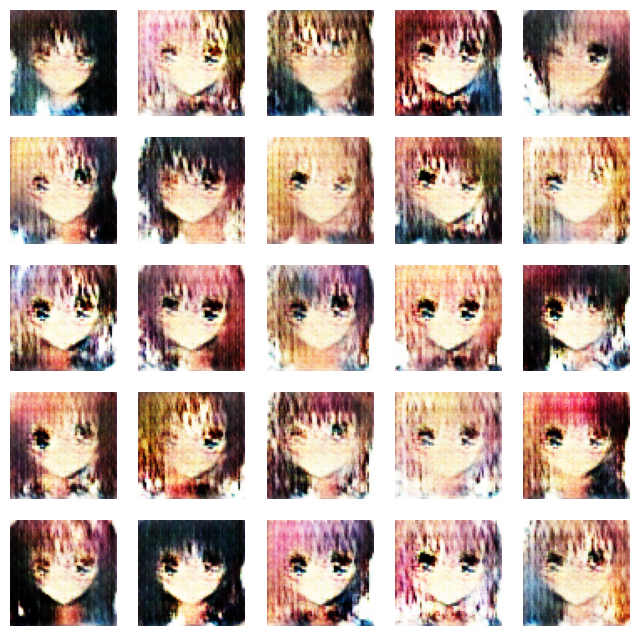

189/189 ━━━━━━━━━━━━━━━━━━━━ 424s 2s/step - d_loss: 0.5996 - g_loss: 1.5279
Epoch 20/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.5945 - g_loss: 1.5787

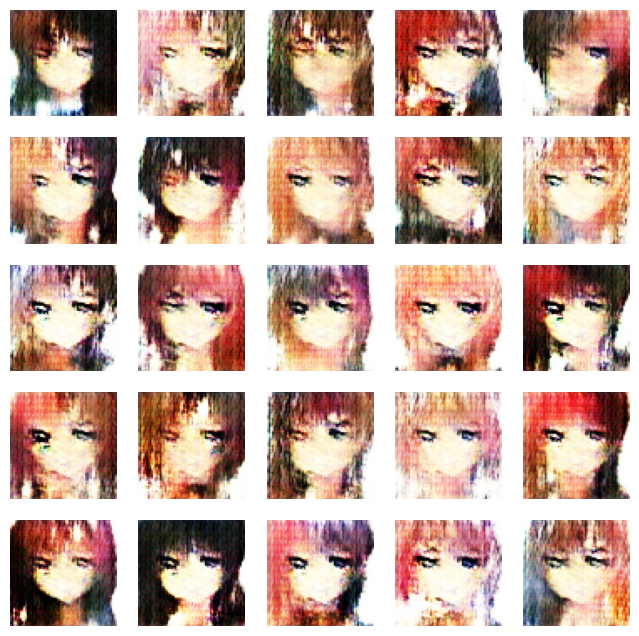

189/189 ━━━━━━━━━━━━━━━━━━━━ 327s 2s/step - d_loss: 0.5946 - g_loss: 1.5786
Epoch 21/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6238 - g_loss: 1.5362

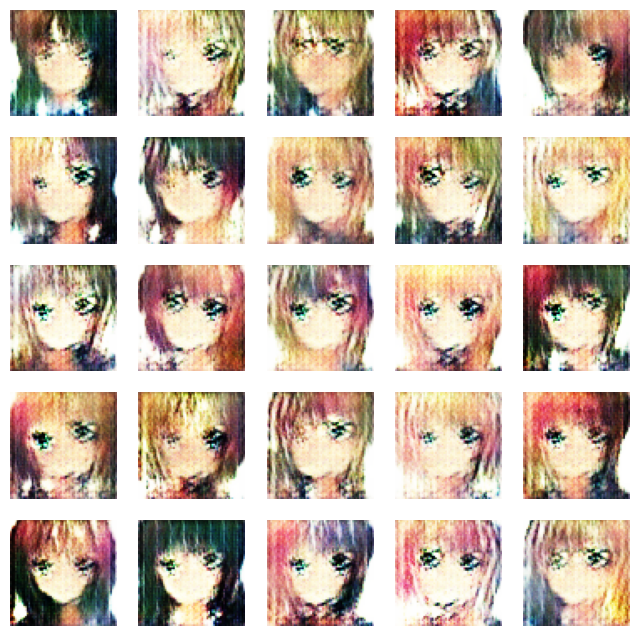

189/189 ━━━━━━━━━━━━━━━━━━━━ 317s 2s/step - d_loss: 0.6238 - g_loss: 1.5359
Epoch 22/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6204 - g_loss: 1.4544

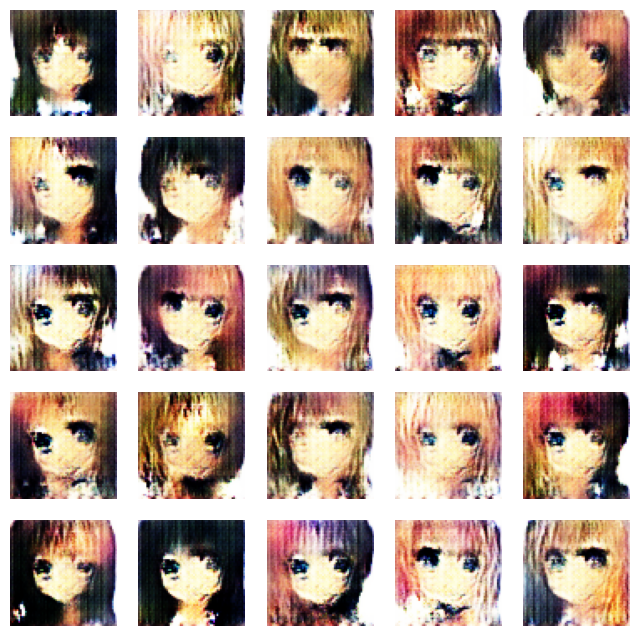

189/189 ━━━━━━━━━━━━━━━━━━━━ 349s 2s/step - d_loss: 0.6204 - g_loss: 1.4548
Epoch 23/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6085 - g_loss: 1.4781

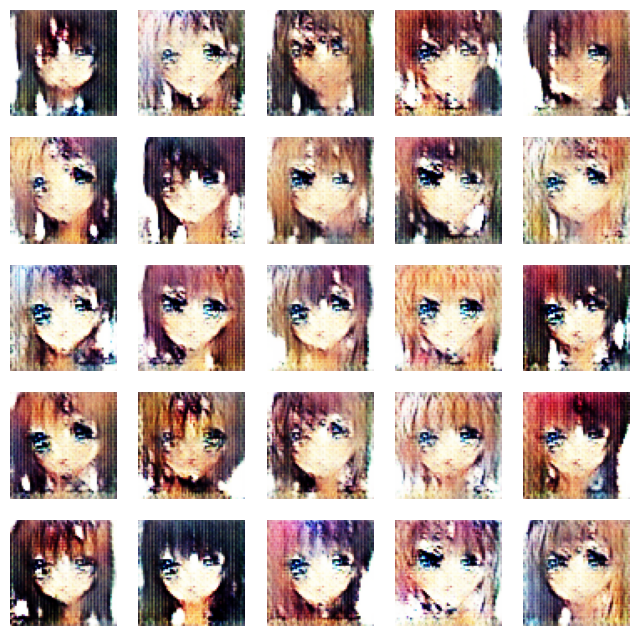

189/189 ━━━━━━━━━━━━━━━━━━━━ 337s 2s/step - d_loss: 0.6085 - g_loss: 1.4785
Epoch 24/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6452 - g_loss: 1.4169

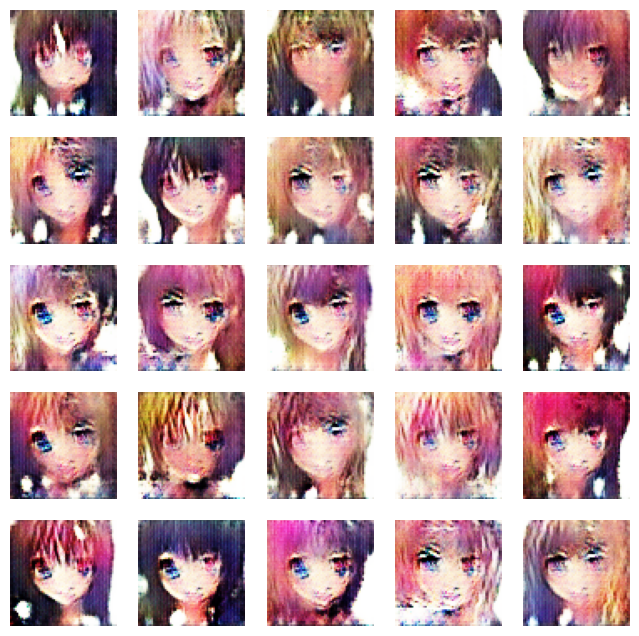

189/189 ━━━━━━━━━━━━━━━━━━━━ 337s 2s/step - d_loss: 0.6452 - g_loss: 1.4165
Epoch 25/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6347 - g_loss: 1.3224

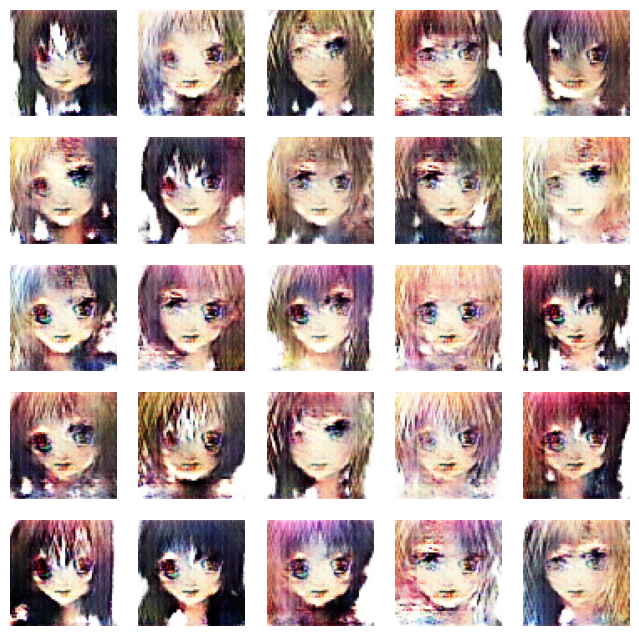

189/189 ━━━━━━━━━━━━━━━━━━━━ 336s 2s/step - d_loss: 0.6347 - g_loss: 1.3223
Epoch 26/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6431 - g_loss: 1.3258

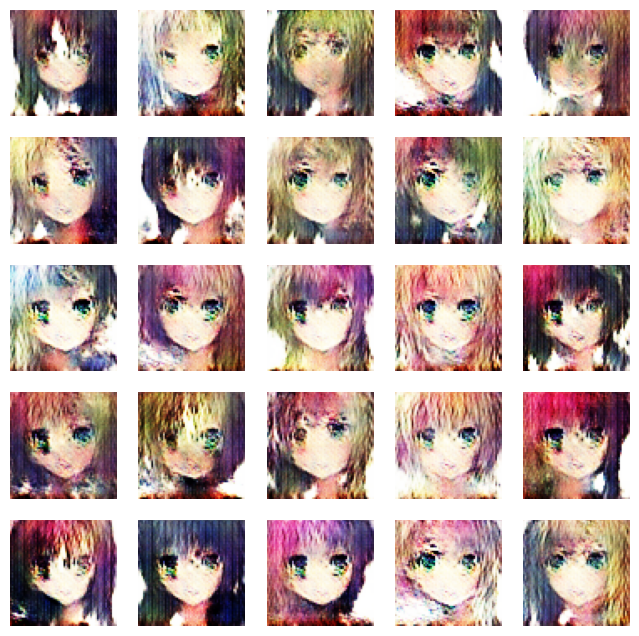

189/189 ━━━━━━━━━━━━━━━━━━━━ 338s 2s/step - d_loss: 0.6431 - g_loss: 1.3256
Epoch 27/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.6636 - g_loss: 1.2799

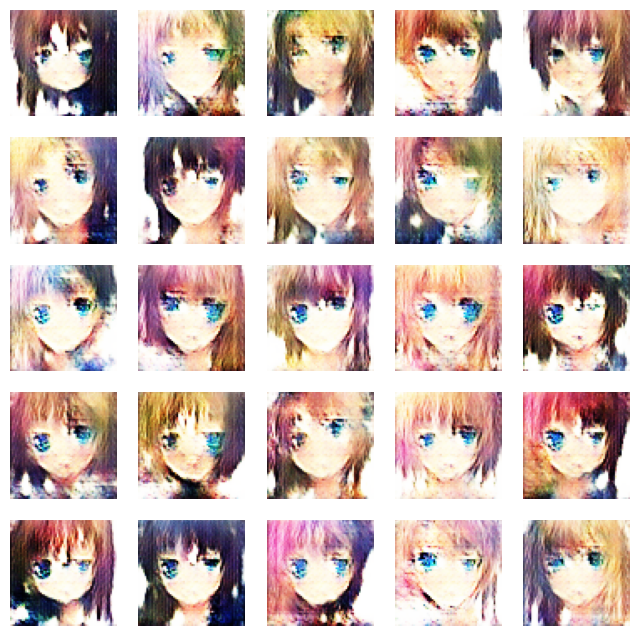

189/189 ━━━━━━━━━━━━━━━━━━━━ 876s 5s/step - d_loss: 0.6637 - g_loss: 1.2796
Epoch 28/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6571 - g_loss: 1.2022

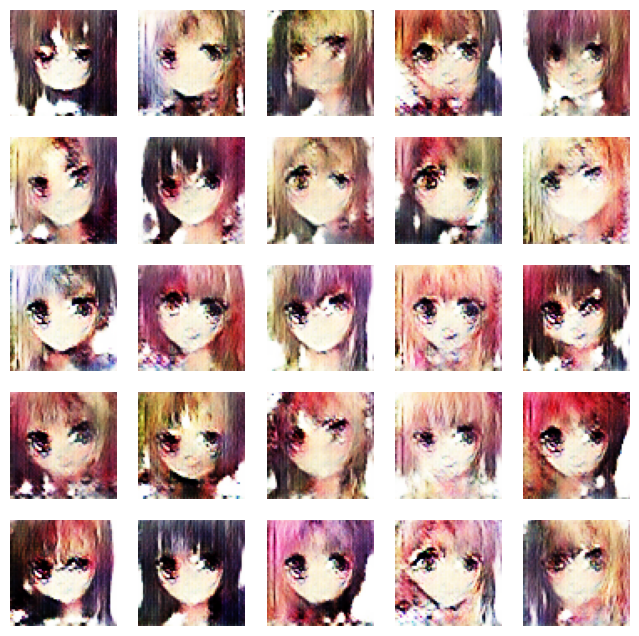

189/189 ━━━━━━━━━━━━━━━━━━━━ 328s 2s/step - d_loss: 0.6570 - g_loss: 1.2021
Epoch 29/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6417 - g_loss: 1.2005

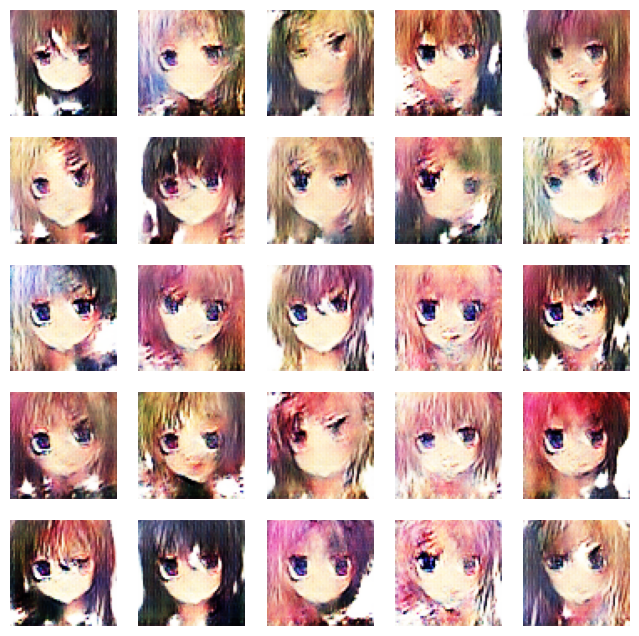

189/189 ━━━━━━━━━━━━━━━━━━━━ 329s 2s/step - d_loss: 0.6416 - g_loss: 1.2005
Epoch 30/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - d_loss: 0.6308 - g_loss: 1.2335

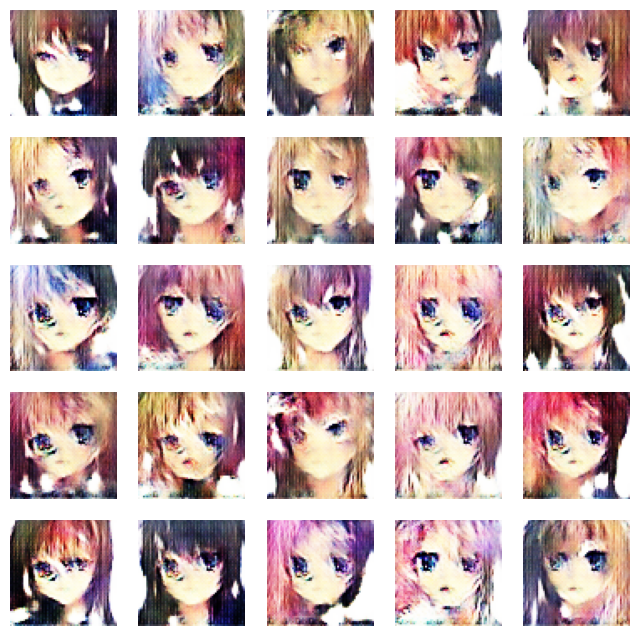

189/189 ━━━━━━━━━━━━━━━━━━━━ 1376s 7s/step - d_loss: 0.6307 - g_loss: 1.2336
Epoch 31/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6270 - g_loss: 1.2824

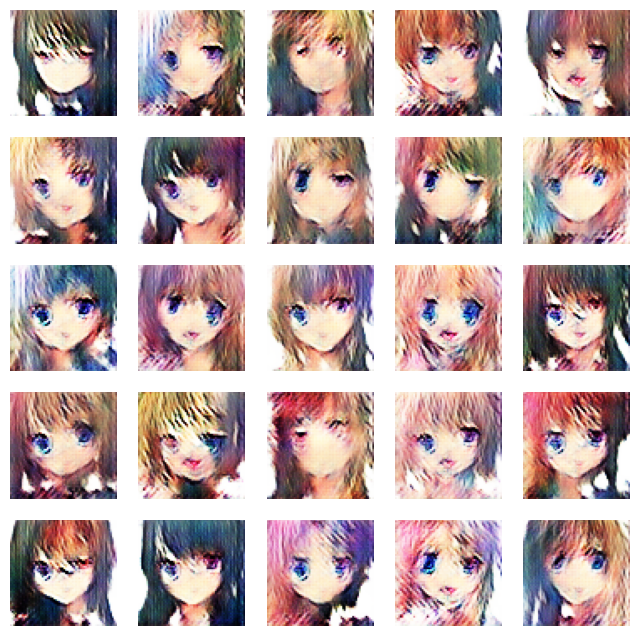

189/189 ━━━━━━━━━━━━━━━━━━━━ 323s 2s/step - d_loss: 0.6270 - g_loss: 1.2821
Epoch 32/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6784 - g_loss: 1.1807

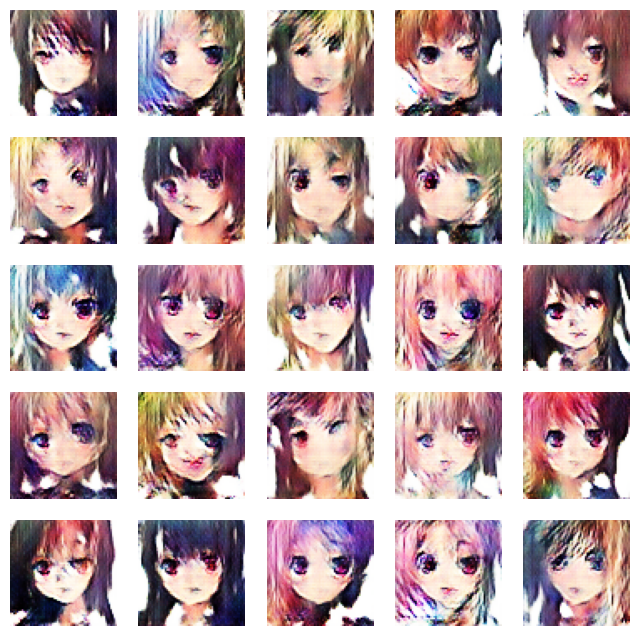

189/189 ━━━━━━━━━━━━━━━━━━━━ 355s 2s/step - d_loss: 0.6784 - g_loss: 1.1805
Epoch 33/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6755 - g_loss: 1.0920

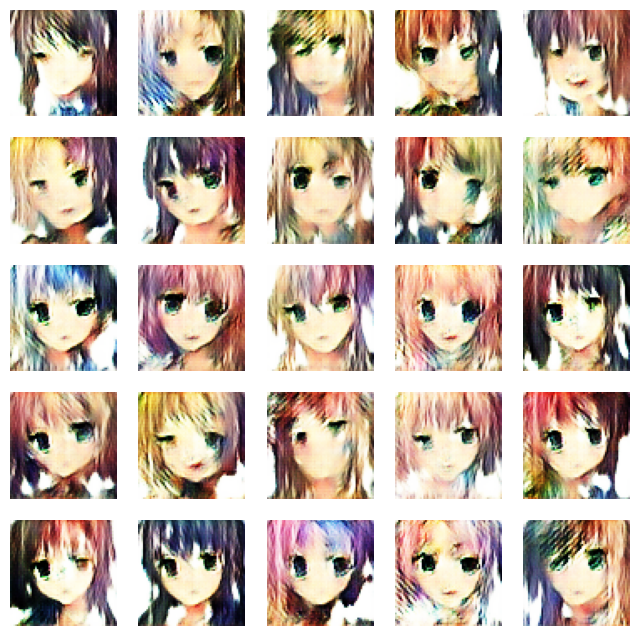

189/189 ━━━━━━━━━━━━━━━━━━━━ 327s 2s/step - d_loss: 0.6755 - g_loss: 1.0920
Epoch 34/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6776 - g_loss: 1.0518

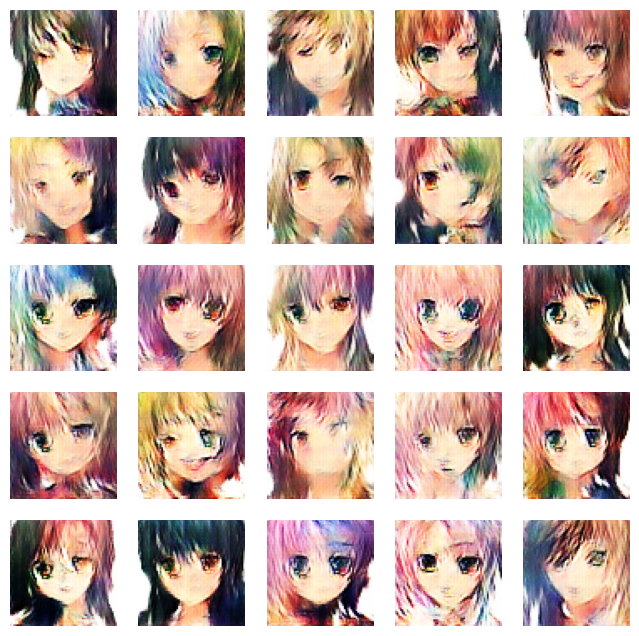

189/189 ━━━━━━━━━━━━━━━━━━━━ 347s 2s/step - d_loss: 0.6776 - g_loss: 1.0518
Epoch 35/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6986 - g_loss: 1.0228

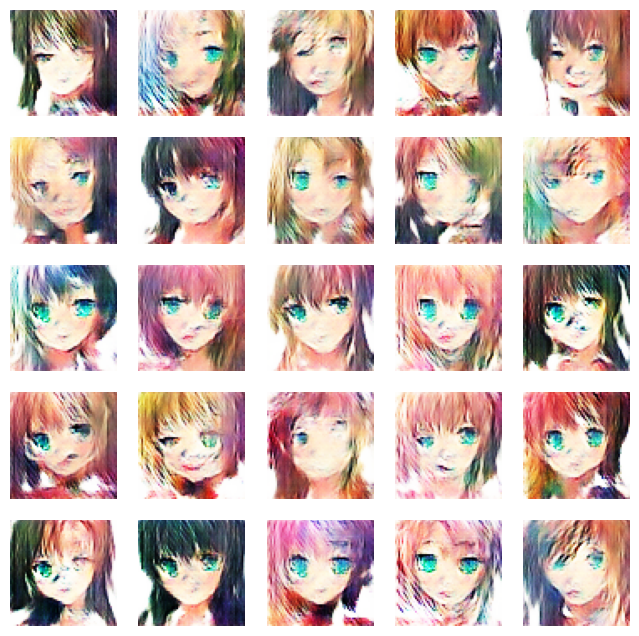

189/189 ━━━━━━━━━━━━━━━━━━━━ 329s 2s/step - d_loss: 0.6986 - g_loss: 1.0226
Epoch 36/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6957 - g_loss: 0.9975

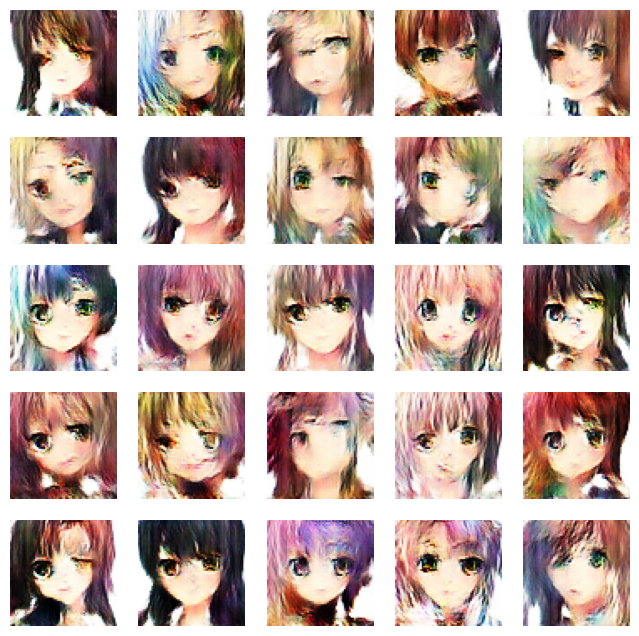

189/189 ━━━━━━━━━━━━━━━━━━━━ 332s 2s/step - d_loss: 0.6957 - g_loss: 0.9973
Epoch 37/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7056 - g_loss: 0.9489

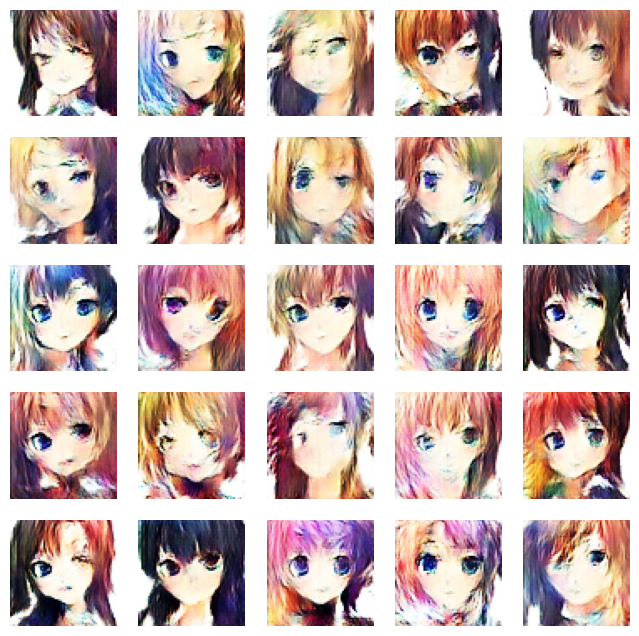

189/189 ━━━━━━━━━━━━━━━━━━━━ 325s 2s/step - d_loss: 0.7056 - g_loss: 0.9489
Epoch 38/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7217 - g_loss: 0.9146

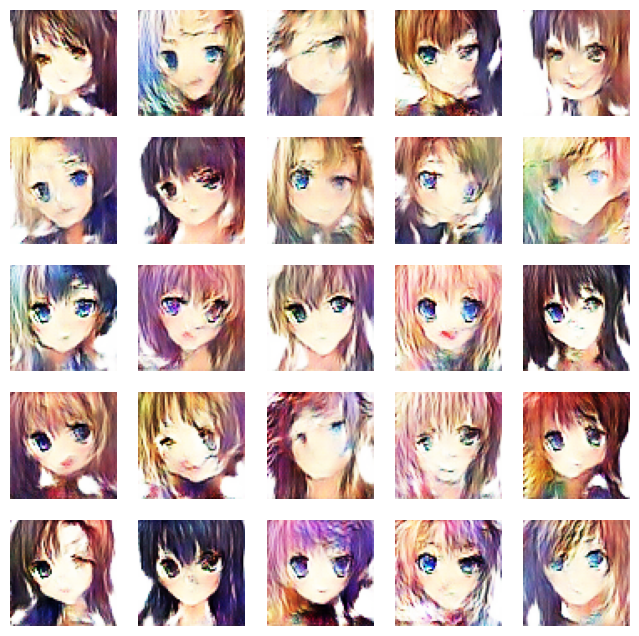

189/189 ━━━━━━━━━━━━━━━━━━━━ 342s 2s/step - d_loss: 0.7216 - g_loss: 0.9145
Epoch 39/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7117 - g_loss: 0.8910

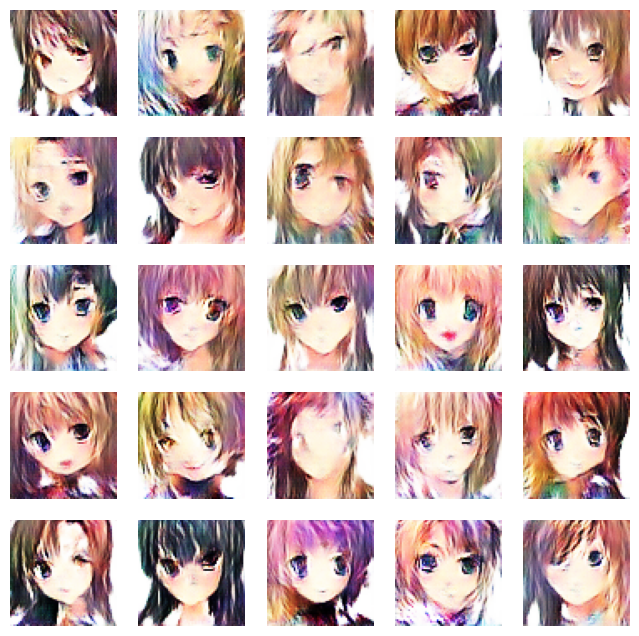

189/189 ━━━━━━━━━━━━━━━━━━━━ 352s 2s/step - d_loss: 0.7117 - g_loss: 0.8910
Epoch 40/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7133 - g_loss: 0.8827

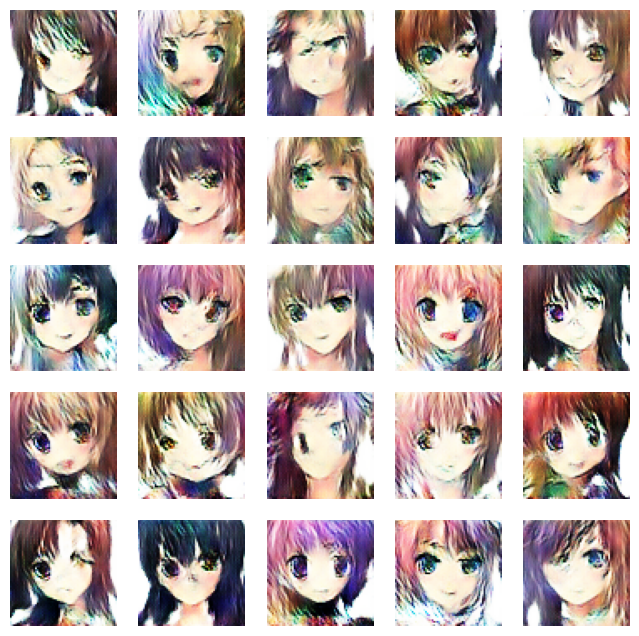

189/189 ━━━━━━━━━━━━━━━━━━━━ 331s 2s/step - d_loss: 0.7134 - g_loss: 0.8827
Epoch 41/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7078 - g_loss: 0.8860

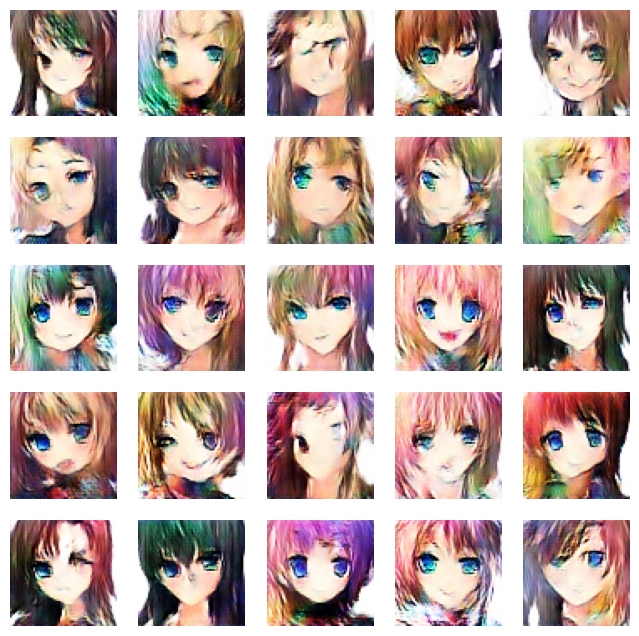

189/189 ━━━━━━━━━━━━━━━━━━━━ 328s 2s/step - d_loss: 0.7078 - g_loss: 0.8860
Epoch 42/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7231 - g_loss: 0.8635

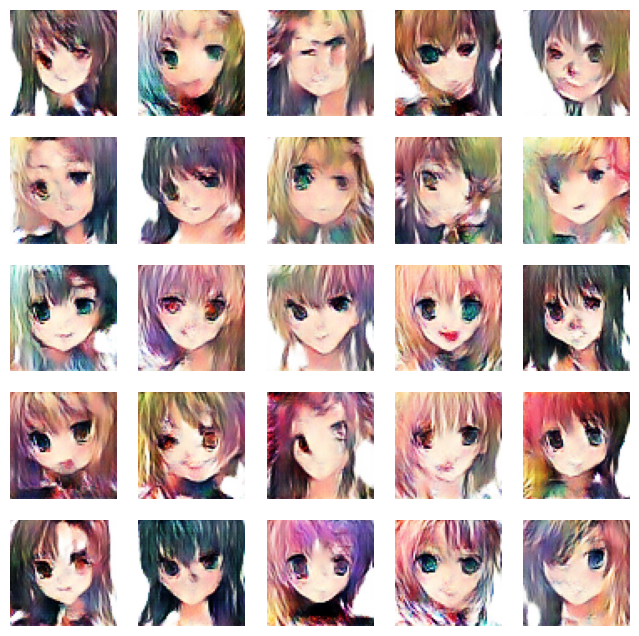

189/189 ━━━━━━━━━━━━━━━━━━━━ 336s 2s/step - d_loss: 0.7231 - g_loss: 0.8634
Epoch 43/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7092 - g_loss: 0.8427

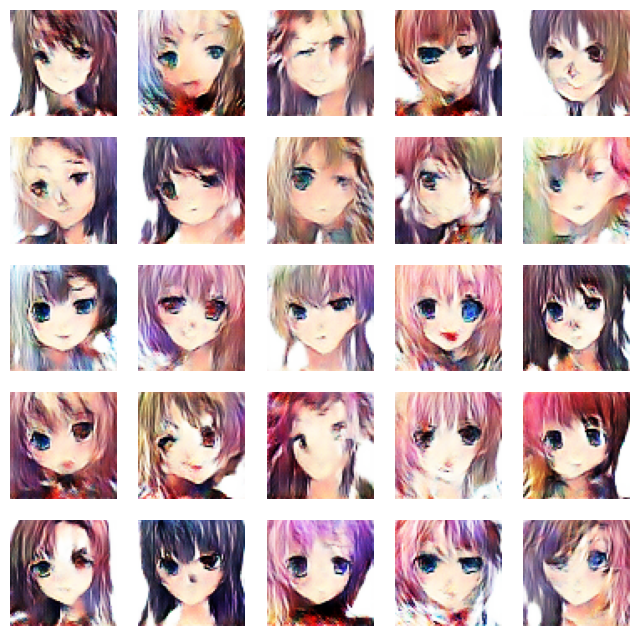

189/189 ━━━━━━━━━━━━━━━━━━━━ 345s 2s/step - d_loss: 0.7092 - g_loss: 0.8427
Epoch 44/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7173 - g_loss: 0.8232

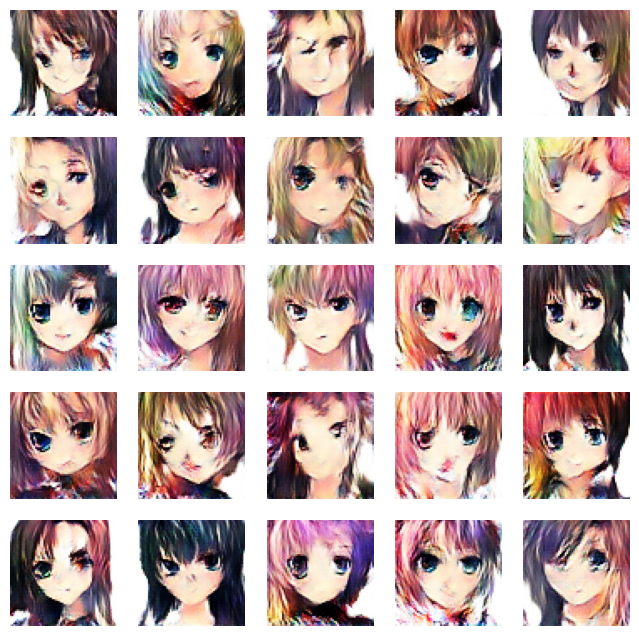

189/189 ━━━━━━━━━━━━━━━━━━━━ 385s 2s/step - d_loss: 0.7173 - g_loss: 0.8232
Epoch 45/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7152 - g_loss: 0.8251

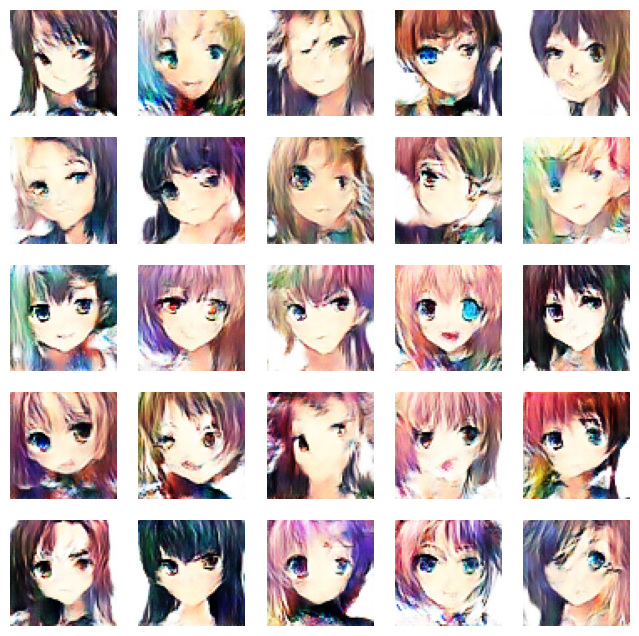

189/189 ━━━━━━━━━━━━━━━━━━━━ 349s 2s/step - d_loss: 0.7152 - g_loss: 0.8251
Epoch 46/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7199 - g_loss: 0.8189

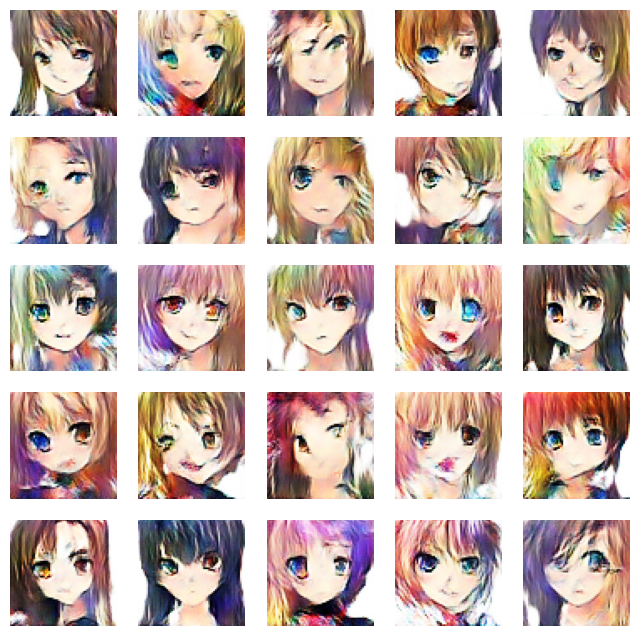

189/189 ━━━━━━━━━━━━━━━━━━━━ 339s 2s/step - d_loss: 0.7199 - g_loss: 0.8188
Epoch 47/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7107 - g_loss: 0.8097

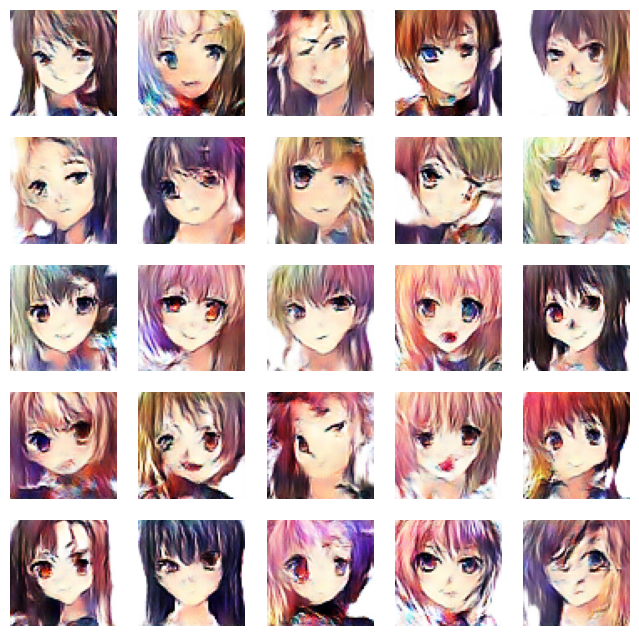

189/189 ━━━━━━━━━━━━━━━━━━━━ 350s 2s/step - d_loss: 0.7107 - g_loss: 0.8097
Epoch 48/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7106 - g_loss: 0.8106

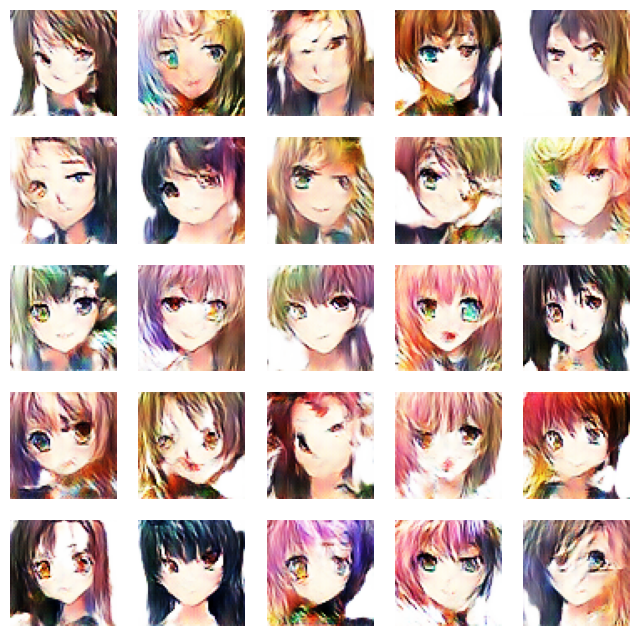

189/189 ━━━━━━━━━━━━━━━━━━━━ 344s 2s/step - d_loss: 0.7106 - g_loss: 0.8106
Epoch 49/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7090 - g_loss: 0.8120

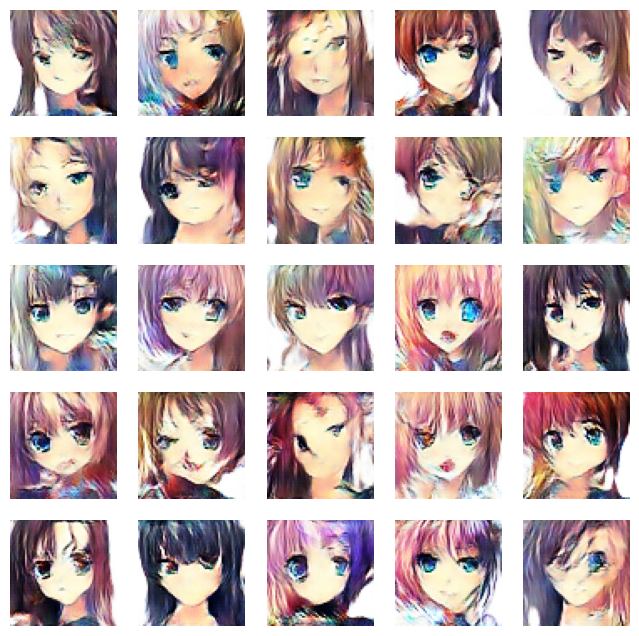

189/189 ━━━━━━━━━━━━━━━━━━━━ 343s 2s/step - d_loss: 0.7091 - g_loss: 0.8119
Epoch 50/50
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7157 - g_loss: 0.8042

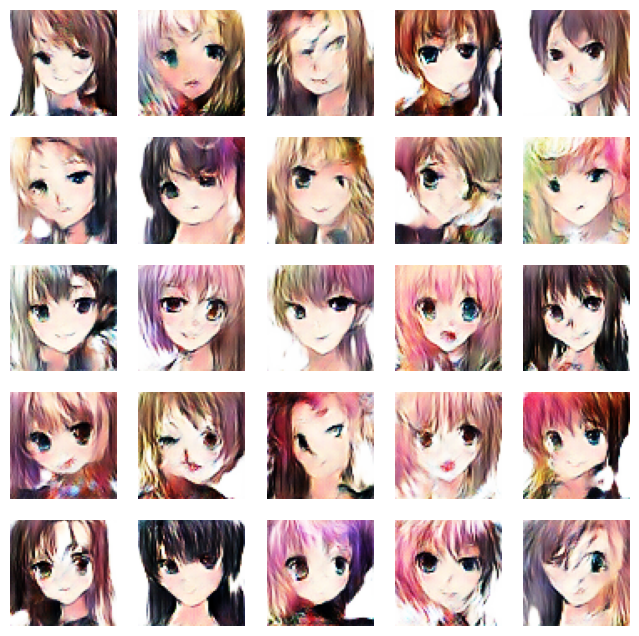

189/189 ━━━━━━━━━━━━━━━━━━━━ 361s 2s/step - d_loss: 0.7157 - g_loss: 0.8042


In [21]:
N_EPOCHS = 50
dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])

## Generate New Anime Image

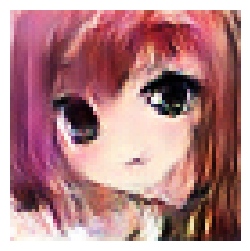

In [31]:
noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(3, 3))
# generate the image from noise
g_img = dcgan.generator(noise)
# denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
# plt.savefig('epoch_{:03d}.png'.format(epoch))
plt.show()

In [32]:
from tensorflow.keras.models import save_model

# Assuming `generator` is your generator model
save_model(generator, 'generator_model.h5')


In [52]:
import pickle

with open('model.pkl', 'wb') as file:
    pickle.dump(generator, file)

print("Model saved to model.pkl")

AttributeError: Can't pickle local object 'Layer._initializer_tracker.<locals>.<lambda>'

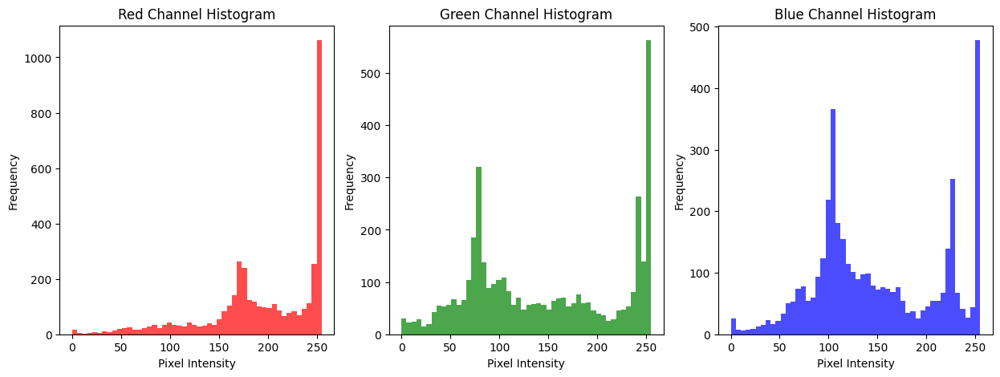

In [48]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.io import imread

# Load or generate your image
# Example:
image_path = 'Data/data/1.png'
generated_image = imread(image_path)

# Flatten the image into a 1D array for histogram plotting
r_channel = generated_image[:, :, 0].flatten()
g_channel = generated_image[:, :, 1].flatten()
b_channel = generated_image[:, :, 2].flatten()

# Plot histograms for each RGB channel
plt.figure(figsize=(15, 5))

# Red channel histogram
plt.subplot(1, 3, 1)
plt.hist(r_channel, bins=50, color='red', alpha=0.7)
plt.title('Red Channel Histogram')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')

# Green channel histogram
plt.subplot(1, 3, 2)
plt.hist(g_channel, bins=50, color='green', alpha=0.7)
plt.title('Green Channel Histogram')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')

# Blue channel histogram
plt.subplot(1, 3, 3)
plt.hist(b_channel, bins=50, color='blue', alpha=0.7)
plt.title('Blue Channel Histogram')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')

plt.show()


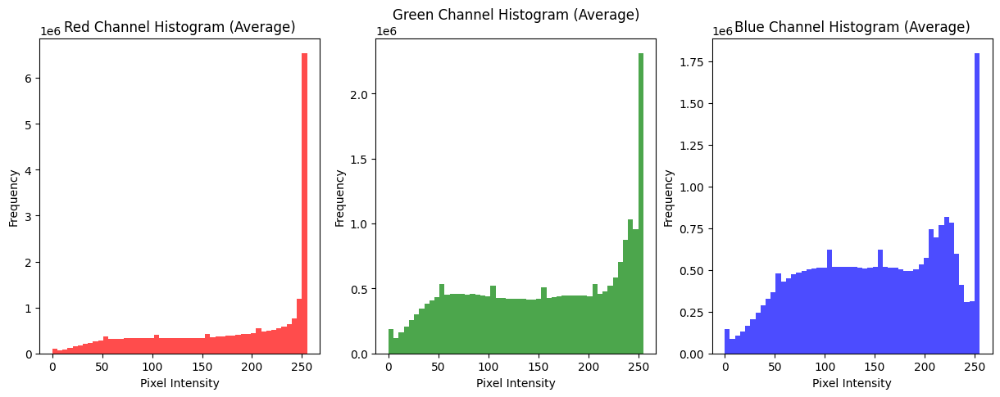

In [51]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.io import imread
import os

# Directory containing your images
images_dir = 'Data/data'

# Function to preprocess and flatten an image
def preprocess_image(image):
    if image.ndim == 2:  # Grayscale image
        image = np.stack((image,) * 3, axis=-1)
    elif image.shape[2] == 1:  # Single channel image
        image = np.concatenate((image,) * 3, axis=-1)
    elif image.shape[2] != 3:  # Image with more than 3 channels
        raise ValueError("Input image must be RGB or grayscale")

    return image

# Initialize lists to store pixel values for each channel
r_channel_values = []
g_channel_values = []
b_channel_values = []

# Iterate over images in the directory
for filename in os.listdir(images_dir):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        image_path = os.path.join(images_dir, filename)
        image = imread(image_path)

        # Preprocess the image
        flat_image = preprocess_image(image)

        # Extract pixel values for each channel
        r_channel_values.extend(flat_image[:, :, 0].flatten())
        g_channel_values.extend(flat_image[:, :, 1].flatten())
        b_channel_values.extend(flat_image[:, :, 2].flatten())

# Convert lists to numpy arrays
r_channel_values = np.array(r_channel_values)
g_channel_values = np.array(g_channel_values)
b_channel_values = np.array(b_channel_values)

# Plot histograms for average pixel values across all images
plt.figure(figsize=(15, 5))

# Red channel histogram
plt.subplot(1, 3, 1)
plt.hist(r_channel_values, bins=50, color='red', alpha=0.7)
plt.title('Red Channel Histogram (Average)')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')

# Green channel histogram
plt.subplot(1, 3, 2)
plt.hist(g_channel_values, bins=50, color='green', alpha=0.7)
plt.title('Green Channel Histogram (Average)')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')

# Blue channel histogram
plt.subplot(1, 3, 3)
plt.hist(b_channel_values, bins=50, color='blue', alpha=0.7)
plt.title('Blue Channel Histogram (Average)')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')

plt.show()
